In [1]:
# Common imports
import os
import sys
from tqdm import tqdm
import numpy as np
from pathlib import Path
import pandas as pd
import random
import cv2
import matplotlib.pyplot as plt
import yaml

# Torch imports
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

# Albumentations for data augmentation
import albumentations as A
from albumentations.pytorch import ToTensorV2

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.5'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [2]:
# Ultralytics YOLO for loading YOLOv11
!pip install ultralytics
from ultralytics import YOLO

In [3]:
#Define the Dataset Class for IP102
class IP102Dataset(Dataset):
    """A dataset class for the IP102 dataset in YOLO format."""

    def __init__(self, data_dir, transform=None):
        """
        Args:
            data_dir (string): Directory with images and labels (e.g., /kaggle/input/ip102-yolov5/IP102_YOLOv5/images/train).
            transform (callable, optional): Optional data augmentation to be applied on a sample.
        """
        self.data_dir = Path(data_dir)
        self.image_list = [f for f in os.listdir(data_dir) if f.endswith('.jpg')]
        self.transform = transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        img_name = self.image_list[idx]
        img_path = str(self.data_dir / img_name)
        label_path = str(self.data_dir.parent.parent / 'labels' / self.data_dir.name / (img_name.replace('.jpg', '.txt')))

        # Load image
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

        # Load labels
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                boxes = [list(map(float, line.strip().split())) for line in f.readlines()]
        else:
            boxes = []

        # Parse boxes
        bboxes = []
        labels = []
        for box in boxes:
            class_id, center_x, center_y, width, height = box
            # Convert YOLO format (normalized) to Pascal VOC format (absolute coordinates)
            img_height, img_width = img.shape[:2]
            xmin = (center_x - width / 2) * img_width
            ymin = (center_y - height / 2) * img_height
            xmax = (center_x + width / 2) * img_width
            ymax = (center_y + height / 2) * img_height
            bboxes.append([xmin, ymin, xmax, ymax])
            labels.append(int(class_id))

        if self.transform:
            transformed = self.transform(image=img, bboxes=bboxes, class_labels=labels)
            img = transformed["image"]
            bboxes = transformed["bboxes"]
            labels = transformed["class_labels"]

        if len(bboxes) > 0:
            bboxes = torch.tensor(bboxes, dtype=torch.float32)
            labels = torch.tensor(labels, dtype=torch.long)
        else:
            bboxes = torch.zeros((0, 4))
            labels = torch.zeros((0,), dtype=torch.long)

        return img, bboxes, labels

In [4]:
# Define Data Augmentation
transform = A.Compose([
    A.LongestMaxSize(416, p=1),
    A.PadIfNeeded(min_height=416, min_width=416, p=1, border_mode=cv2.BORDER_CONSTANT, value=0),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels'], min_area=20))

/tmp/ipykernel_116/3553826755.py:4: UserWarning: Argument(s) 'value' are not valid for transform PadIfNeeded
  A.PadIfNeeded(min_height=416, min_width=416, p=1, border_mode=cv2.BORDER_CONSTANT, value=0),


In [5]:
# Set Up the Dataset and DataLoader
train_data_dir = "/kaggle/input/ip102-yolov5/IP102_YOLOv5/images/train"
val_data_dir = "/kaggle/input/ip102-yolov5/IP102_YOLOv5/images/val"

train_dataset = IP102Dataset(train_data_dir, transform=transform)
val_dataset = IP102Dataset(val_data_dir, transform=transform)

def collate_fn(batch):
    images, bboxes, labels = zip(*batch)
    images = torch.stack(images, dim=0)
    return images, bboxes, labels

train_dataloader = DataLoader(
    train_dataset,
    batch_size=16,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=2
)

val_dataloader = DataLoader(
    val_dataset,
    batch_size=16,
    shuffle=False,
    collate_fn=collate_fn,
    num_workers=2
)

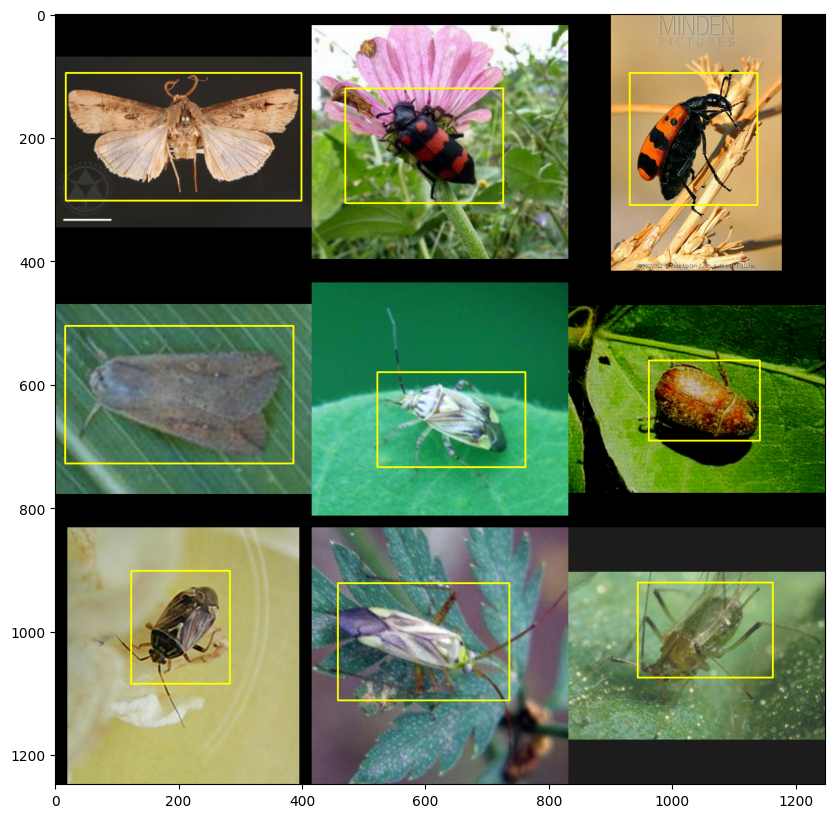

In [6]:
# Sanity Check of the Dataset
hlines = []
for i in range(3):
    vlines = []
    for j in range(3):
        idx = random.randint(0, len(train_dataset) - 1)
        img, bboxes, labels = train_dataset[idx]
        img = img.permute(1, 2, 0).numpy() * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = (img * 255).astype(np.uint8)

        for bbox in bboxes:
            x1, y1, x2, y2 = map(int, bbox)
            cv2.rectangle(img, (x1, y1), (x2, y2), (255, 255, 0), 2)

        vlines.append(img)
    hlines.append(cv2.vconcat(vlines))

final_img = cv2.hconcat(hlines)
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
plt.imshow(final_img)
plt.show()

In [7]:
# Load Pre-trained YOLOv8 Model
model = YOLO("/kaggle/input/yolov8/pytorch/default/1/yolov8s.pt")

In [8]:
# Copy the original ip102.yaml to the working directory and modify the paths
original_yaml_path = "/kaggle/input/ip102-yolov5/IP102_YOLOv5/ip102.yaml"
new_yaml_path = "/kaggle/working/ip102_corrected.yaml"

# Read the original YAML file
with open(original_yaml_path, 'r') as f:
    yaml_content = yaml.safe_load(f)

# Update the paths to the correct absolute paths
yaml_content['train'] = "/kaggle/input/ip102-yolov5/IP102_YOLOv5/images/train"
yaml_content['val'] = "/kaggle/input/ip102-yolov5/IP102_YOLOv5/images/val"

# Save the modified YAML file
with open(new_yaml_path, 'w') as f:
    yaml.dump(yaml_content, f)

print(f"Modified ip102.yaml saved to {new_yaml_path}")
print("Updated paths:")
print(f"train: {yaml_content['train']}")
print(f"val: {yaml_content['val']}")

Modified ip102.yaml saved to /kaggle/working/ip102_corrected.yaml
Updated paths:
train: /kaggle/input/ip102-yolov5/IP102_YOLOv5/images/train
val: /kaggle/input/ip102-yolov5/IP102_YOLOv5/images/val


In [9]:
# Train the Model Using Ultralytics YOLO API
# The Ultralytics YOLO implementation simplifies training by handling the loss function and training loop internally.
# We just need to provide the dataset configuration and training parameters.

# Train the model
results = model.train(
    data=new_yaml_path,
    epochs=50,
    imgsz=416,
    batch=16,
    warmup_epochs=5,
    device=0,
    patience=15,
    save=True,
    project="/kaggle/working/yolo_training",
    name="ip102_yolov8s",
    cos_lr=True,
    lr0=0.001,
    augment=True,
    verbose=True
)

Ultralytics 8.3.156 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/kaggle/working/ip102_corrected.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/kaggle/input/yolov8/pytorch/default/1/yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=ip102_yolov8s2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, 

train: Scanning /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels/train... 17646 images, 0 backgrounds, 0 corrupt: 100%|██████████| 17646/17646 [00:58<00:00, 302.00it/s]


WARNING ⚠️ train: Cache directory /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 6.0±3.6 MB/s, size: 25.0 KB)


val: Scanning /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels/val... 1329 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1329/1329 [00:04<00:00, 309.10it/s]


WARNING ⚠️ val: Cache directory /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels is not writeable, cache not saved.
Plotting labels to /kaggle/working/yolo_training/ip102_yolov8s2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 4 dataloader workers
Logging results to /kaggle/working/yolo_training/ip102_yolov8s2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       1.8G      1.524      3.569      1.596         55        416: 100%|██████████| 1103/1103 [03:14<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:08<00:00,  5.18it/s]


                   all       1329       1621      0.596      0.229      0.195      0.118

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.05G       1.35      2.359      1.419         40        416: 100%|██████████| 1103/1103 [03:05<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.09it/s]


                   all       1329       1621      0.559      0.275      0.265      0.156

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.07G      1.361      2.166      1.425         45        416: 100%|██████████| 1103/1103 [03:03<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.11it/s]


                   all       1329       1621      0.524      0.247      0.237      0.137

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       2.1G      1.388      2.192      1.438         36        416: 100%|██████████| 1103/1103 [03:02<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.12it/s]


                   all       1329       1621      0.668      0.223      0.282       0.16

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.12G      1.433      2.273      1.454         43        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.02it/s]


                   all       1329       1621      0.532        0.3      0.279       0.16

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.15G      1.452      2.321      1.468         37        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:07<00:00,  5.79it/s]


                   all       1329       1621       0.53      0.304      0.275      0.158

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.17G       1.42      2.204      1.442         37        416: 100%|██████████| 1103/1103 [03:02<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:07<00:00,  5.84it/s]


                   all       1329       1621       0.56      0.342      0.345      0.208

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       2.2G      1.392      2.079      1.424         47        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.06it/s]


                   all       1329       1621      0.472      0.432      0.375      0.233

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.22G      1.378      1.999      1.407         52        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.00it/s]


                   all       1329       1621      0.496      0.422      0.421      0.252

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.24G      1.358      1.911      1.397         45        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.23it/s]


                   all       1329       1621      0.431      0.469      0.421      0.258

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.27G      1.355      1.884      1.394         48        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.19it/s]


                   all       1329       1621      0.492      0.415      0.416      0.253

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.29G      1.331      1.825      1.382         42        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.14it/s]


                   all       1329       1621      0.556       0.43      0.465      0.286

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.32G      1.317      1.757      1.371         26        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.13it/s]


                   all       1329       1621       0.42      0.535       0.47      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.34G      1.309      1.733      1.366         40        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.05it/s]


                   all       1329       1621      0.534      0.523      0.488      0.305

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.37G      1.303      1.706      1.359         35        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.11it/s]


                   all       1329       1621      0.535      0.483      0.502      0.317

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.39G      1.297      1.671      1.357         35        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.02it/s]


                   all       1329       1621      0.417      0.566      0.537      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.41G      1.285       1.63      1.351         40        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.14it/s]


                   all       1329       1621      0.448      0.599      0.529      0.325

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.48G      1.276      1.601      1.345         37        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.06it/s]


                   all       1329       1621      0.476      0.646      0.576       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.51G      1.265      1.564      1.336         32        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.25it/s]


                   all       1329       1621      0.511      0.582      0.547      0.338

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.53G      1.262      1.533      1.339         39        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.23it/s]

                   all       1329       1621      0.512      0.559      0.568      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50       2.6G      1.247      1.513       1.33         36        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.22it/s]

                   all       1329       1621       0.55      0.552      0.588      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.62G      1.248      1.484       1.33         38        416: 100%|██████████| 1103/1103 [03:01<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.473      0.622      0.588      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       2.7G       1.24      1.464      1.324         48        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.33it/s]

                   all       1329       1621      0.535       0.59      0.595      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.72G      1.225      1.428      1.316         34        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.22it/s]

                   all       1329       1621      0.523      0.608      0.618      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.79G      1.218      1.408      1.314         43        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.18it/s]


                   all       1329       1621      0.519      0.627      0.616      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.81G      1.213      1.372      1.309         38        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.12it/s]


                   all       1329       1621      0.544      0.607      0.629      0.398

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.84G      1.205      1.364      1.305         40        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.12it/s]

                   all       1329       1621      0.522      0.653      0.629      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.91G      1.196      1.349      1.301         36        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.22it/s]

                   all       1329       1621      0.573      0.624      0.643      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.98G       1.19      1.323      1.294         42        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.501      0.674      0.642      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         3G      1.178      1.299      1.292         72        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.33it/s]

                   all       1329       1621      0.513      0.668      0.638      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      3.07G      1.172      1.274      1.284         43        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.41it/s]

                   all       1329       1621      0.533      0.621       0.63      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      3.09G      1.167      1.249      1.283         35        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.531      0.649      0.655      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      3.12G      1.156      1.236      1.281         47        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.20it/s]

                   all       1329       1621      0.538      0.666      0.665      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      3.36G      1.154      1.213      1.276         39        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.36it/s]

                   all       1329       1621      0.539       0.65      0.679      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      3.38G      1.139      1.184      1.267         42        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.22it/s]


                   all       1329       1621      0.503      0.691      0.673      0.425

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      3.41G      1.136      1.171      1.267         41        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.21it/s]

                   all       1329       1621      0.509      0.685      0.668      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      3.43G      1.128      1.152      1.262         35        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.539       0.68      0.668      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      3.46G      1.125      1.139       1.26         42        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.533       0.68      0.672      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      3.48G      1.116      1.121      1.256         47        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.32it/s]

                   all       1329       1621      0.546      0.669      0.667       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       3.5G      1.106        1.1      1.247         34        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.529      0.684      0.669      0.422


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      3.53G      1.046      0.796      1.277         15        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.33it/s]

                   all       1329       1621      0.521      0.694      0.677      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      3.55G      1.033     0.7616      1.269         15        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.31it/s]

                   all       1329       1621      0.524      0.698      0.678      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      3.58G      1.015     0.7424      1.261         14        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.22it/s]

                   all       1329       1621      0.533      0.678      0.681      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       3.6G      1.009     0.7279      1.255         16        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.27it/s]

                   all       1329       1621      0.544      0.675      0.677      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      3.67G     0.9998      0.715       1.25         14        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.22it/s]

                   all       1329       1621       0.55      0.676      0.679      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50       3.7G     0.9906      0.703      1.243         24        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.34it/s]

                   all       1329       1621      0.578      0.665      0.681      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      3.76G     0.9846     0.6956      1.239         19        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.27it/s]

                   all       1329       1621      0.556      0.685      0.679      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      3.79G     0.9778     0.6878      1.236         40        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.33it/s]

                   all       1329       1621      0.584      0.643      0.678      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      3.81G     0.9775     0.6868      1.235         14        416: 100%|██████████| 1103/1103 [02:59<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.33it/s]

                   all       1329       1621      0.576      0.639      0.676      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      3.88G      0.975     0.6816      1.233         14        416: 100%|██████████| 1103/1103 [03:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:06<00:00,  6.24it/s]


                   all       1329       1621      0.584      0.631      0.678      0.429

50 epochs completed in 2.616 hours.
Optimizer stripped from /kaggle/working/yolo_training/ip102_yolov8s2/weights/last.pt, 22.6MB
Optimizer stripped from /kaggle/working/yolo_training/ip102_yolov8s2/weights/best.pt, 22.6MB

Validating /kaggle/working/yolo_training/ip102_yolov8s2/weights/best.pt...
Ultralytics 8.3.156 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 11,165,058 parameters, 0 gradients, 28.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [00:10<00:00,  3.91it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1329       1621      0.533      0.692      0.682      0.438
      rice leaf roller         12         13      0.766      0.923      0.957      0.689
 rice leaf caterpillar          8          8      0.358      0.489      0.374      0.236
     paddy stem maggot          2          2      0.365        0.5      0.745      0.398
    asiatic rice borer         12         13      0.605      0.769      0.754      0.458
     yellow rice borer          6          6      0.858      0.833      0.915      0.573
       rice gall midge          7          7       0.63      0.857      0.856      0.375
          Rice Stemfly          2          2      0.282        0.5       0.39      0.207
    brown plant hopper          8          8      0.602        0.5      0.626      0.361
white backed plant hopper          5          5       0.57          1      0.962      0.642
small brown plant hopper          4          4      0.459       0.75       0.67      0.317
     rice water 

In [10]:
# Evaluate on Validation Set
val_results = model.val(data=new_yaml_path, split="val")
print(f"Validation mAP@0.5: {val_results.box.map50:.4f}")
print(f"Validation mAP@0.5:0.95: {val_results.box.map:.4f}")

Ultralytics 8.3.156 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 11,165,058 parameters, 0 gradients, 28.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 31.7±32.6 MB/s, size: 19.0 KB)


val: Scanning /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels/val... 1329 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1329/1329 [00:01<00:00, 778.98it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 84/84 [00:11<00:00,  7.02it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1329       1621      0.528      0.682      0.676      0.434
      rice leaf roller         12         13      0.767      0.923      0.957       0.69
 rice leaf caterpillar          8          8      0.362      0.498      0.298      0.186
     paddy stem maggot          2          2      0.366        0.5      0.745      0.398
    asiatic rice borer         12         13      0.576      0.769      0.763      0.463
     yellow rice borer          6          6      0.858      0.833      0.909      0.571
       rice gall midge          7          7       0.63      0.857      0.869      0.385
          Rice Stemfly          2          2      0.283        0.5      0.414      0.217
    brown plant hopper          8          8      0.603        0.5      0.618      0.358
white backed plant hopper          5          5       0.57          1      0.962      0.619
small brown plant hopper          4          4       0.46       0.75       0.67      0.317
     rice water 

In [ ]:
# Export for Mobile Deployment
# Export to ONNX
model.export(format="onnx", imgsz=416)

Ultralytics 8.3.156 🚀 Python-3.11.11 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel CPUs. Learn more at https://docs.ultralytics.com/integrations/openvino/

PyTorch: starting from '/kaggle/working/yolo_training/ip102_yolov8s2/weights/best.pt' with input shape (1, 3, 416, 416) BCHW and output shape(s) (1, 106, 3549) (21.5 MB)
requirements: Ultralytics requirements ['onnxslim>=0.1.56', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 3.2s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.57...
ONNX: export success ✅ 5.4s, saved as '/kaggle/working/yolo_training/ip102_yolov8s2/weights/best.onnx' (42.7 MB)

Export complete (5.7s)
Results saved to /kaggle/working/yolo_training/ip102_yolov8s2/weights
Predict:         yolo predict task=detect model=/kaggle/working/yolo_tr

'/kaggle/working/yolo_training/ip102_yolov8s2/weights/best.onnx'

Loaded trained YOLOv11 model from /kaggle/working/yolo_training/ip102_yolov8s2/weights/best.pt
Processing image: corn borer_15482.jpg (432x326)
No detections for corn borer_15482.jpg with confidence threshold 0.1


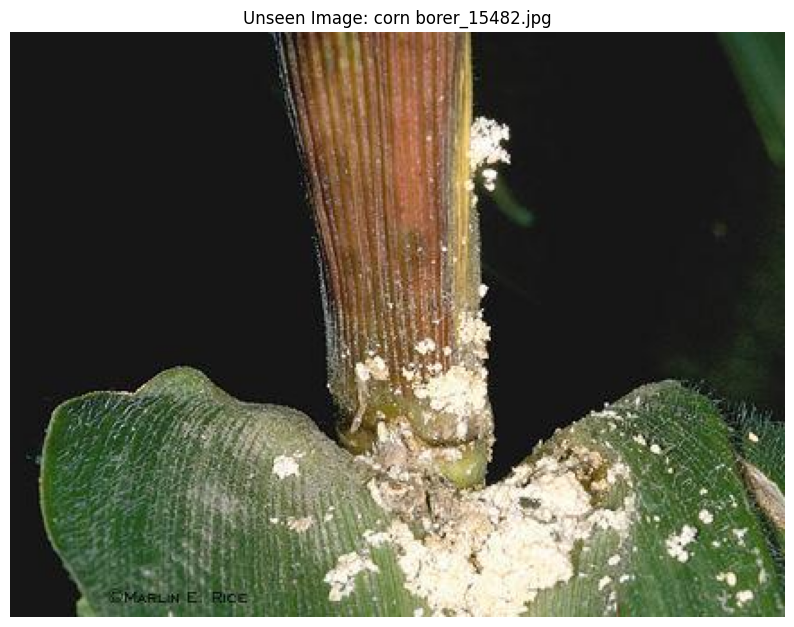


Detection Results for corn borer_15482.jpg (Confidence Threshold 0.1):
No detections found. Consider lowering the confidence threshold or retraining the model.
Processing image: Termite_Aug_SL8 Microtermes obesi Holmgren_178.jpg (256x256)


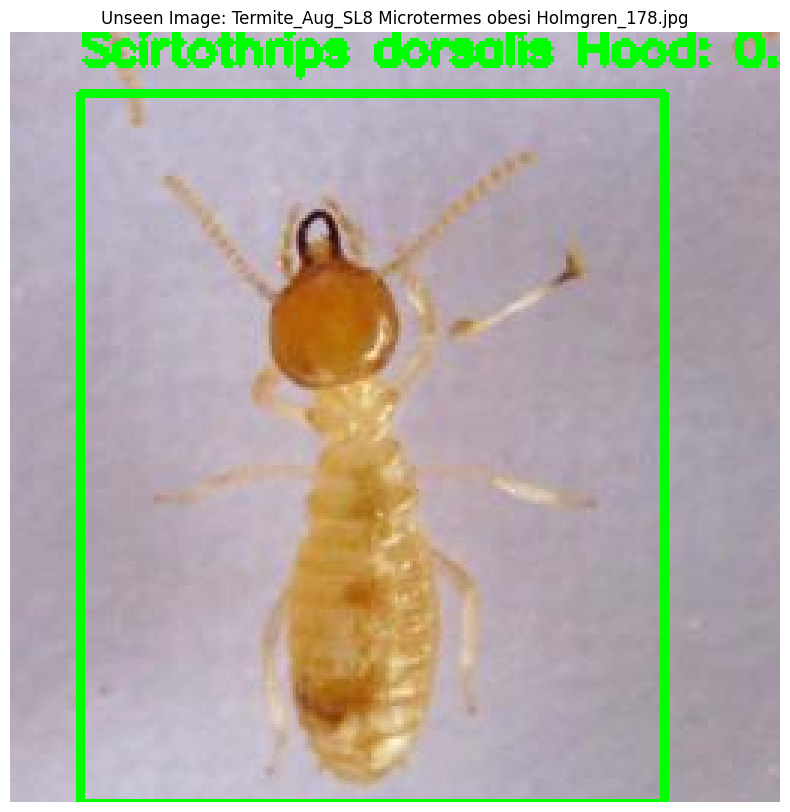


Detection Results for Termite_Aug_SL8 Microtermes obesi Holmgren_178.jpg (Confidence Threshold 0.1):
Class: Scirtothrips dorsalis Hood, Confidence: 0.63, Box: [xmin=24, ymin=20, xmax=218, ymax=256]
Processing image: white backed plant hopper_05156.jpg (512x528)
No detections for white backed plant hopper_05156.jpg with confidence threshold 0.1


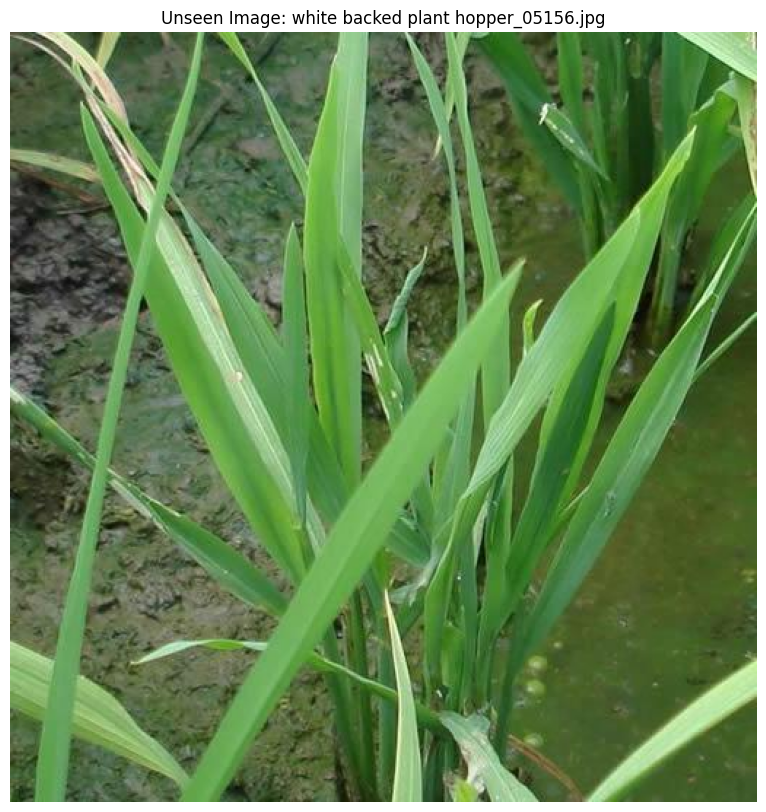


Detection Results for white backed plant hopper_05156.jpg (Confidence Threshold 0.1):
No detections found. Consider lowering the confidence threshold or retraining the model.
Processing image: cutworm_92.Black-Cutworm.jpg (591x443)


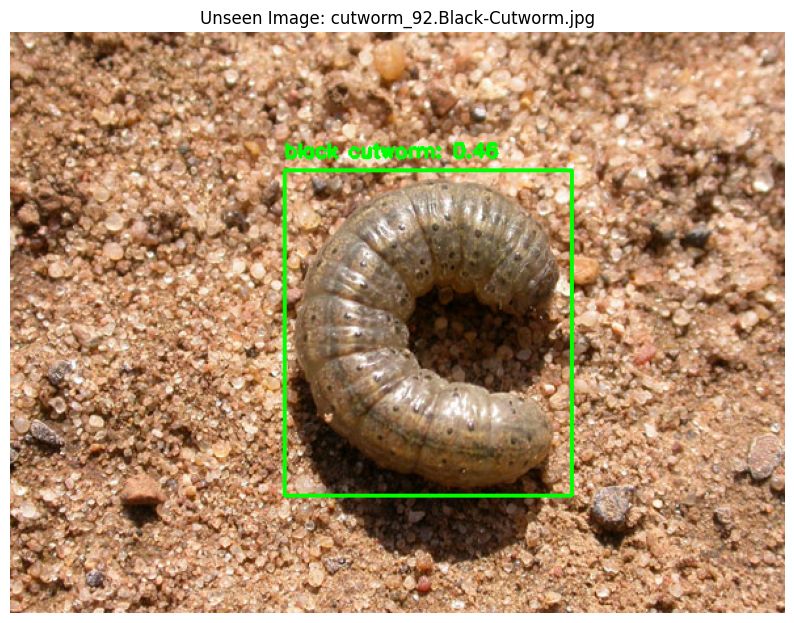


Detection Results for cutworm_92.Black-Cutworm.jpg (Confidence Threshold 0.1):
Class: black cutworm, Confidence: 0.46, Box: [xmin=209, ymin=105, xmax=428, ymax=353]
Processing image: alfalfa weevil_30721.jpg (539x352)


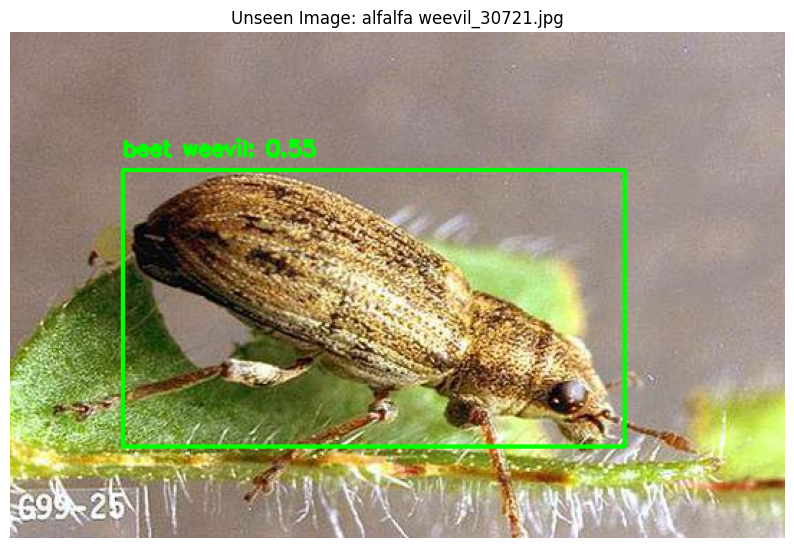


Detection Results for alfalfa weevil_30721.jpg (Confidence Threshold 0.1):
Class: beet weevil, Confidence: 0.55, Box: [xmin=79, ymin=96, xmax=428, ymax=289]
Processing image: grasshopper_jpg_22 - Copy.jpg (299x168)


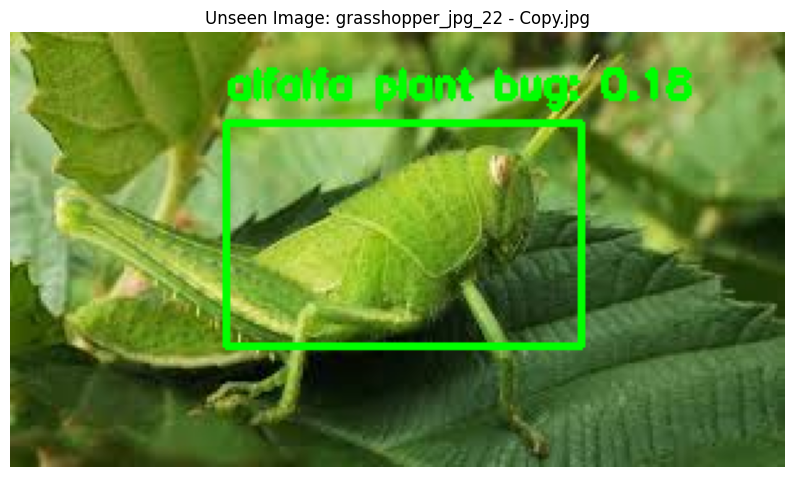


Detection Results for grasshopper_jpg_22 - Copy.jpg (Confidence Threshold 0.1):
Class: alfalfa plant bug, Confidence: 0.18, Box: [xmin=84, ymin=35, xmax=220, ymax=122]
Processing image: Pod borer_Aug_Earias cupreoviridis Walker_357.jpg (256x256)


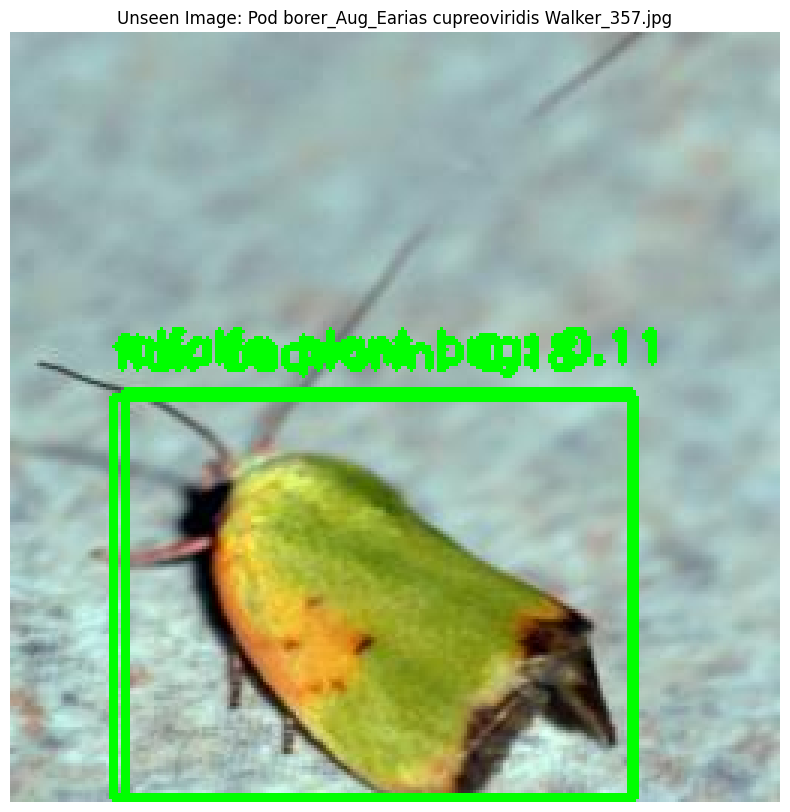


Detection Results for Pod borer_Aug_Earias cupreoviridis Walker_357.jpg (Confidence Threshold 0.1):
Class: flax budworm, Confidence: 0.18, Box: [xmin=35, ymin=122, xmax=208, ymax=255]
Class: alfalfa plant bug, Confidence: 0.11, Box: [xmin=38, ymin=120, xmax=207, ymax=256]
Processing image: Gall fly_GallFlyImage477.jpeg (224x224)


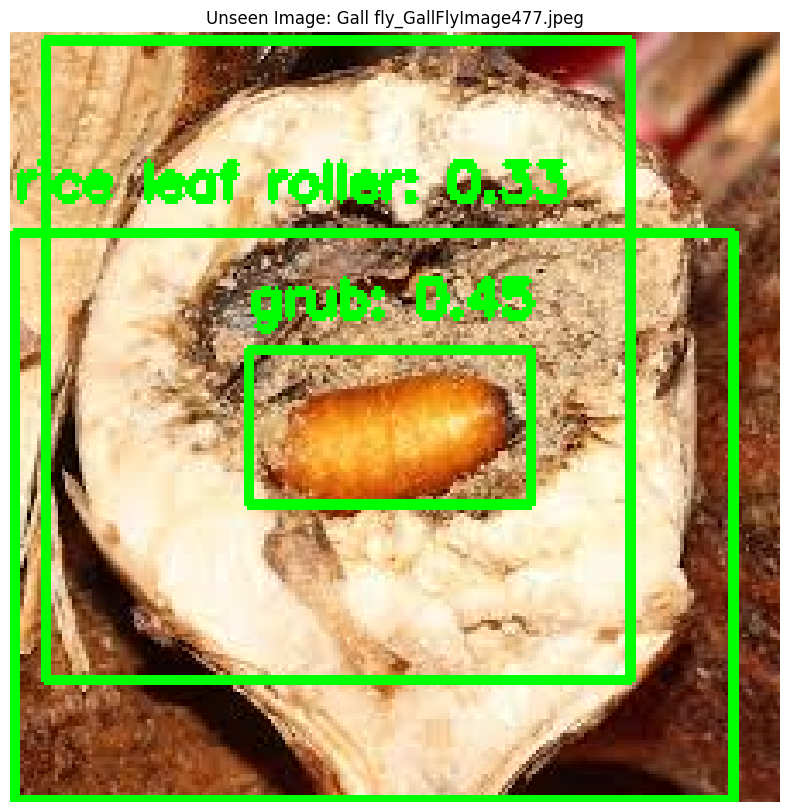


Detection Results for Gall fly_GallFlyImage477.jpeg (Confidence Threshold 0.1):
Class: grub, Confidence: 0.45, Box: [xmin=70, ymin=93, xmax=152, ymax=138]
Class: grub, Confidence: 0.40, Box: [xmin=10, ymin=3, xmax=181, ymax=189]
Class: rice leaf roller, Confidence: 0.33, Box: [xmin=1, ymin=59, xmax=211, ymax=224]
Processing image: grub_08463.jpg (500x375)


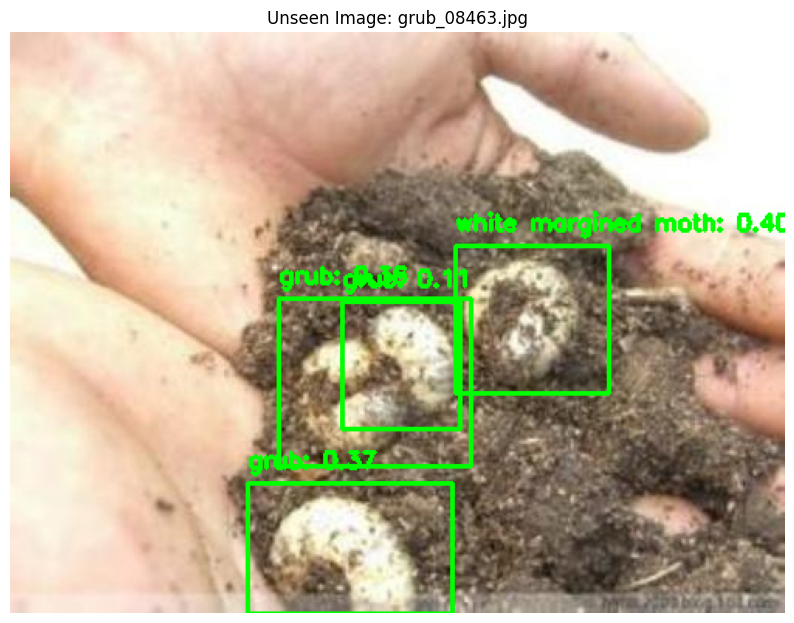


Detection Results for grub_08463.jpg (Confidence Threshold 0.1):
Class: white margined moth, Confidence: 0.40, Box: [xmin=287, ymin=139, xmax=386, ymax=234]
Class: grub, Confidence: 0.37, Box: [xmin=153, ymin=291, xmax=285, ymax=375]
Class: grub, Confidence: 0.36, Box: [xmin=174, ymin=173, xmax=297, ymax=281]
Class: grub, Confidence: 0.11, Box: [xmin=215, ymin=175, xmax=291, ymax=257]
Processing image: Viteus vitifoliae_42695.jpg (350x262)


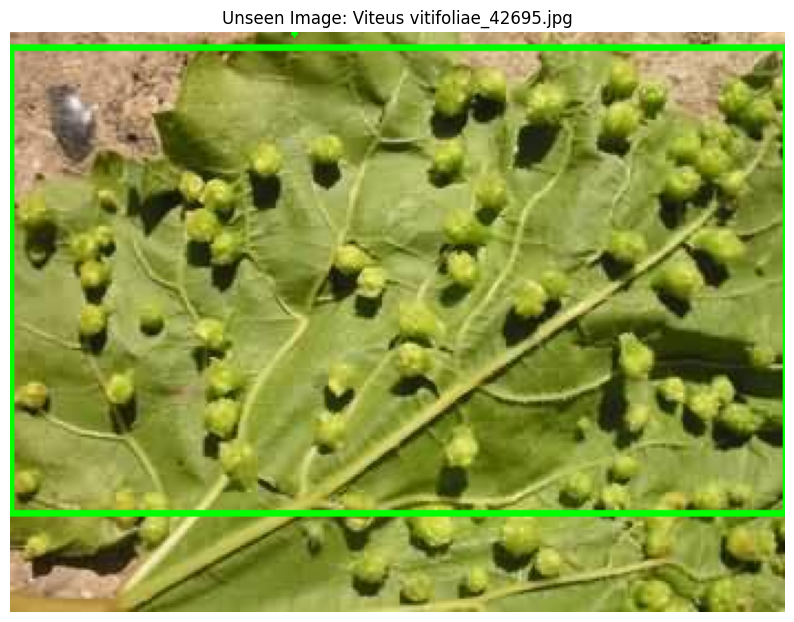


Detection Results for Viteus vitifoliae_42695.jpg (Confidence Threshold 0.1):
Class: Aleurocanthus spiniferus, Confidence: 0.46, Box: [xmin=0, ymin=7, xmax=350, ymax=218]
Processing image: Jute aphid_Aug_Aphis gossypii Glover_355.jpg (256x256)


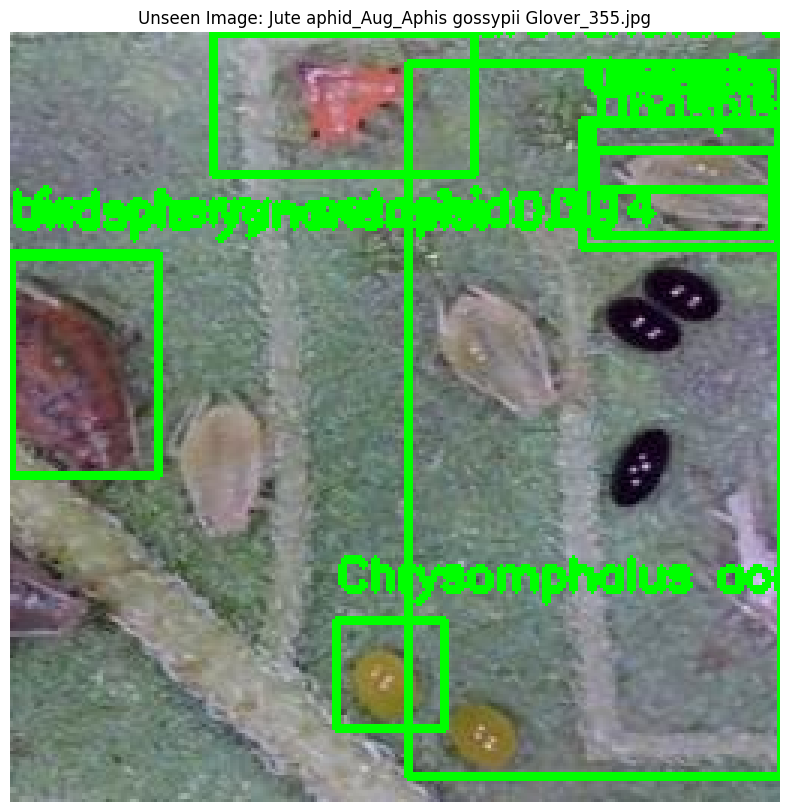


Detection Results for Jute aphid_Aug_Aphis gossypii Glover_355.jpg (Confidence Threshold 0.1):
Class: Aleurocanthus spiniferus, Confidence: 0.41, Box: [xmin=132, ymin=11, xmax=256, ymax=247]
Class: Unaspis yanonensis, Confidence: 0.37, Box: [xmin=190, ymin=30, xmax=256, ymax=71]
Class: Unaspis yanonensis, Confidence: 0.19, Box: [xmin=0, ymin=75, xmax=49, ymax=148]
Class: Unaspis yanonensis, Confidence: 0.17, Box: [xmin=194, ymin=39, xmax=254, ymax=68]
Class: Panonchus citri McGregor, Confidence: 0.15, Box: [xmin=67, ymin=0, xmax=155, ymax=47]
Class: bird cherry-oataphid, Confidence: 0.14, Box: [xmin=0, ymin=73, xmax=50, ymax=147]
Class: Unaspis yanonensis, Confidence: 0.12, Box: [xmin=193, ymin=30, xmax=255, ymax=53]
Class: Chrysomphalus aonidum, Confidence: 0.10, Box: [xmin=109, ymin=196, xmax=144, ymax=231]
Processing image: Colomerus vitis_42889.jpg (200x200)


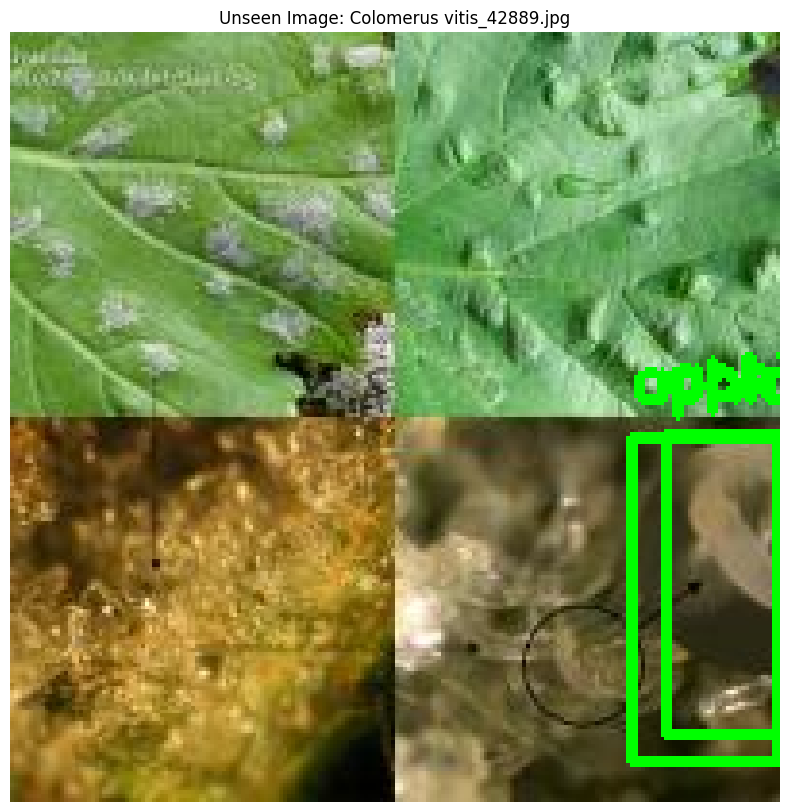


Detection Results for Colomerus vitis_42889.jpg (Confidence Threshold 0.1):
Class: aphids, Confidence: 0.25, Box: [xmin=161, ymin=106, xmax=200, ymax=189]
Class: aphids, Confidence: 0.12, Box: [xmin=171, ymin=105, xmax=200, ymax=182]
Processing image: Lycorma delicatula_49472.jpg (226x289)


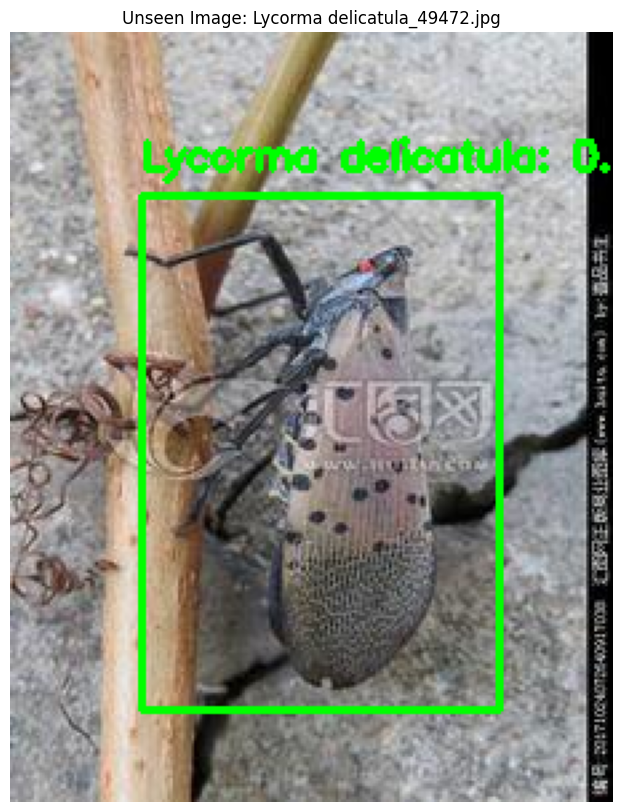


Detection Results for Lycorma delicatula_49472.jpg (Confidence Threshold 0.1):
Class: Lycorma delicatula, Confidence: 0.72, Box: [xmin=50, ymin=62, xmax=183, ymax=255]
Processing image: rice leaf roller_00316.jpg (690x536)


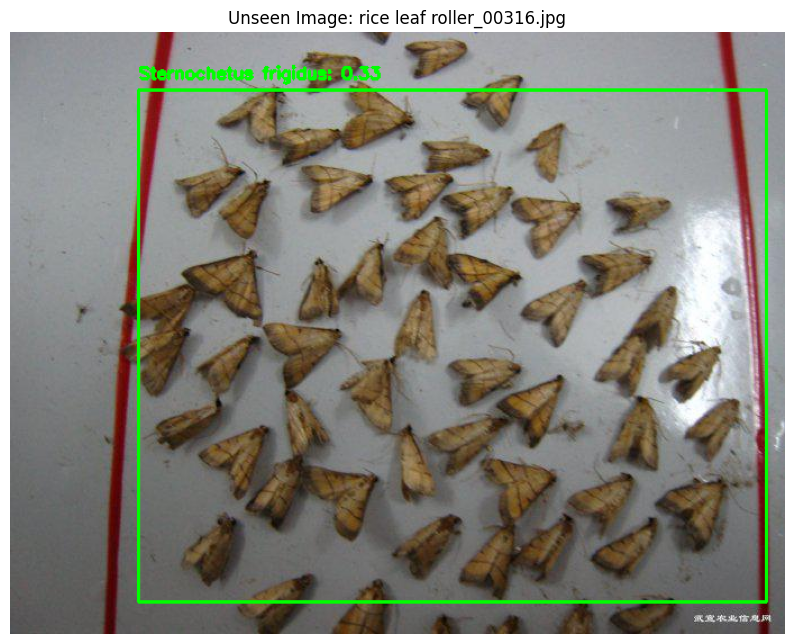


Detection Results for rice leaf roller_00316.jpg (Confidence Threshold 0.1):
Class: Sternochetus frigidus, Confidence: 0.33, Box: [xmin=114, ymin=52, xmax=674, ymax=508]
Processing image: longlegged spider mite_24851.jpg (960x640)


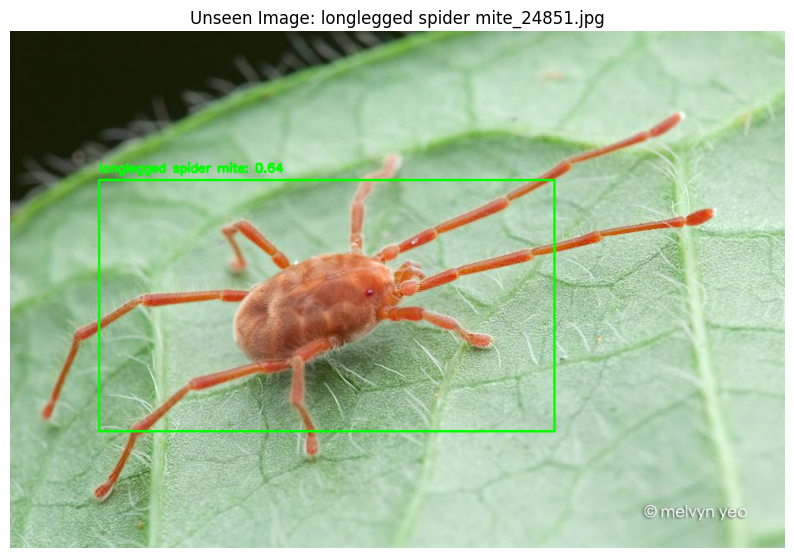


Detection Results for longlegged spider mite_24851.jpg (Confidence Threshold 0.1):
Class: longlegged spider mite, Confidence: 0.64, Box: [xmin=110, ymin=184, xmax=674, ymax=496]
Processing image: Miridae_55971.jpg (500x374)


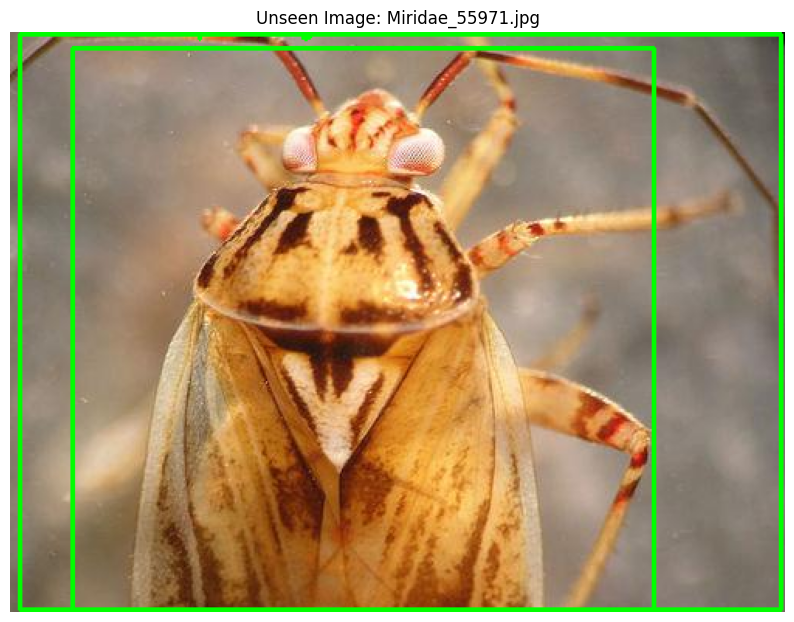


Detection Results for Miridae_55971.jpg (Confidence Threshold 0.1):
Class: Miridae, Confidence: 0.56, Box: [xmin=6, ymin=1, xmax=498, ymax=372]
Class: tarnished plant bug, Confidence: 0.38, Box: [xmin=41, ymin=10, xmax=416, ymax=374]
Processing image: flea beetle_26688.jpg (2048x1365)
No detections for flea beetle_26688.jpg with confidence threshold 0.1


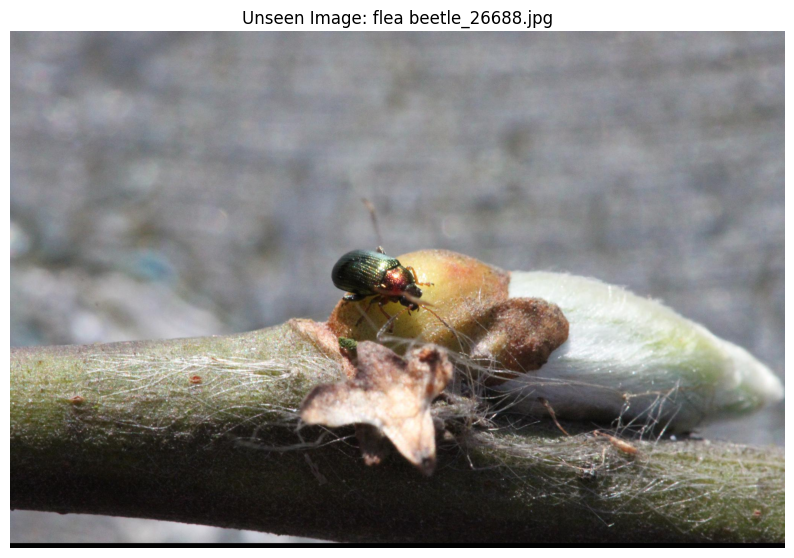


Detection Results for flea beetle_26688.jpg (Confidence Threshold 0.1):
No detections found. Consider lowering the confidence threshold or retraining the model.
Processing image: Jute stem girdler_Aug_Nupserha bicolor (Dutta)_147.jpg (256x256)


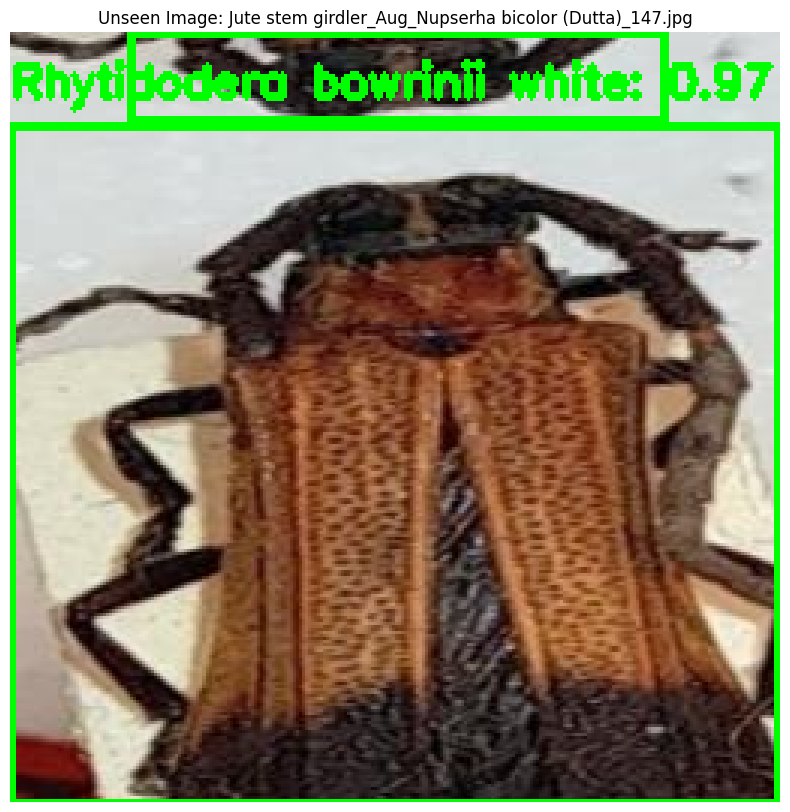


Detection Results for Jute stem girdler_Aug_Nupserha bicolor (Dutta)_147.jpg (Confidence Threshold 0.1):
Class: Rhytidodera bowrinii white, Confidence: 0.97, Box: [xmin=0, ymin=31, xmax=256, ymax=256]
Class: Potosiabre vitarsis, Confidence: 0.11, Box: [xmin=40, ymin=0, xmax=217, ymax=29]
Processing image: blister beetle_37576.jpg (500x333)


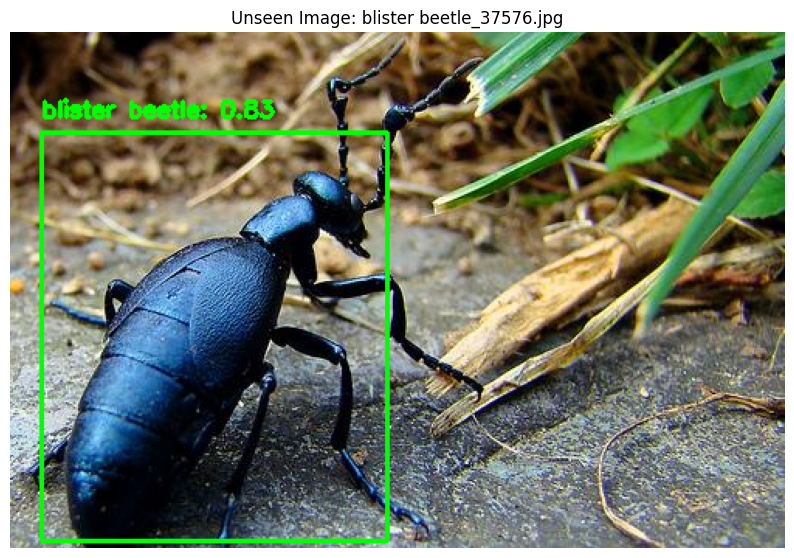


Detection Results for blister beetle_37576.jpg (Confidence Threshold 0.1):
Class: blister beetle, Confidence: 0.83, Box: [xmin=20, ymin=66, xmax=244, ymax=328]
Processing image: rice leafhopper_07692.jpg (360x340)


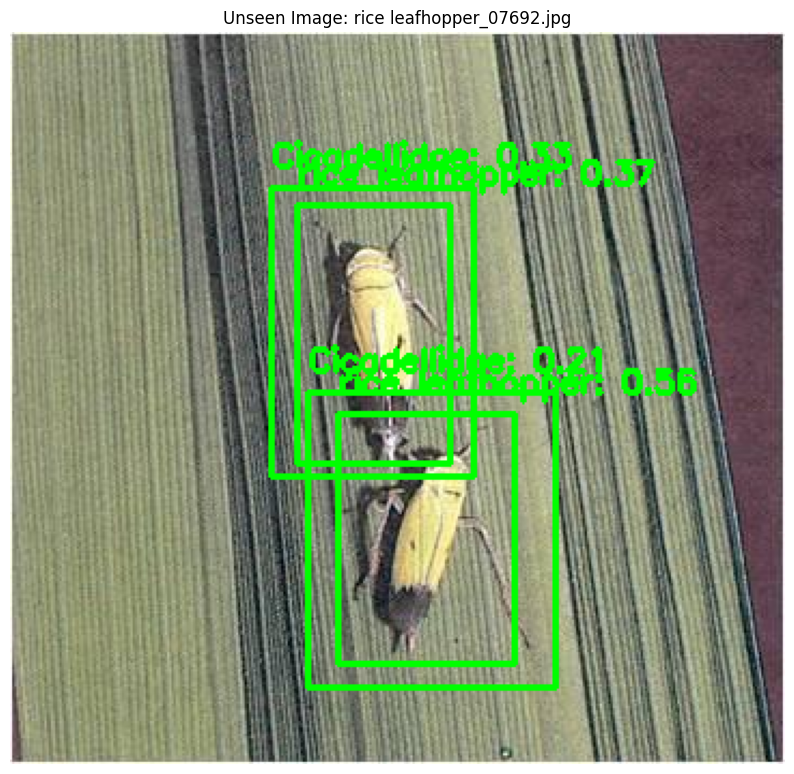


Detection Results for rice leafhopper_07692.jpg (Confidence Threshold 0.1):
Class: rice leafhopper, Confidence: 0.56, Box: [xmin=152, ymin=177, xmax=234, ymax=294]
Class: rice leafhopper, Confidence: 0.37, Box: [xmin=133, ymin=80, xmax=205, ymax=200]
Class: Cicadellidae, Confidence: 0.33, Box: [xmin=122, ymin=72, xmax=215, ymax=206]
Class: Cicadellidae, Confidence: 0.21, Box: [xmin=139, ymin=167, xmax=253, ymax=305]
Processing image: whitefly_th62 (3).jpg (239x159)


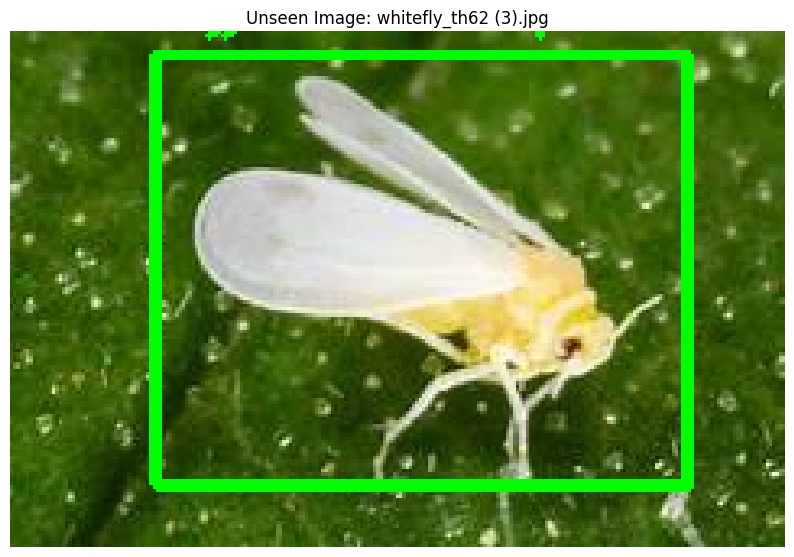


Detection Results for whitefly_th62 (3).jpg (Confidence Threshold 0.1):
Class: Phyllocnistis citrella Stainton, Confidence: 0.64, Box: [xmin=45, ymin=7, xmax=210, ymax=141]
Class: Erythroneura apicalis, Confidence: 0.33, Box: [xmin=44, ymin=8, xmax=209, ymax=139]
Processing image: mole cricket_09325.jpg (500x328)


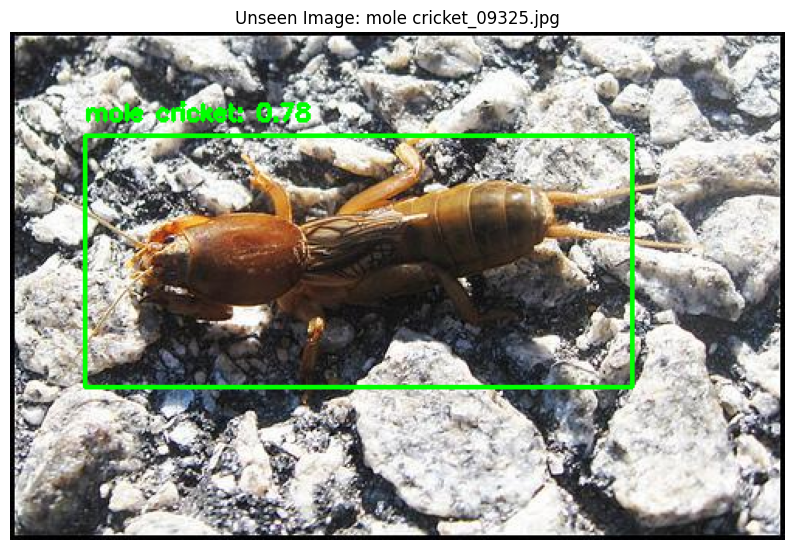


Detection Results for mole cricket_09325.jpg (Confidence Threshold 0.1):
Class: mole cricket, Confidence: 0.78, Box: [xmin=48, ymin=67, xmax=402, ymax=229]
Processing image: aphids_19786.jpg (266x181)


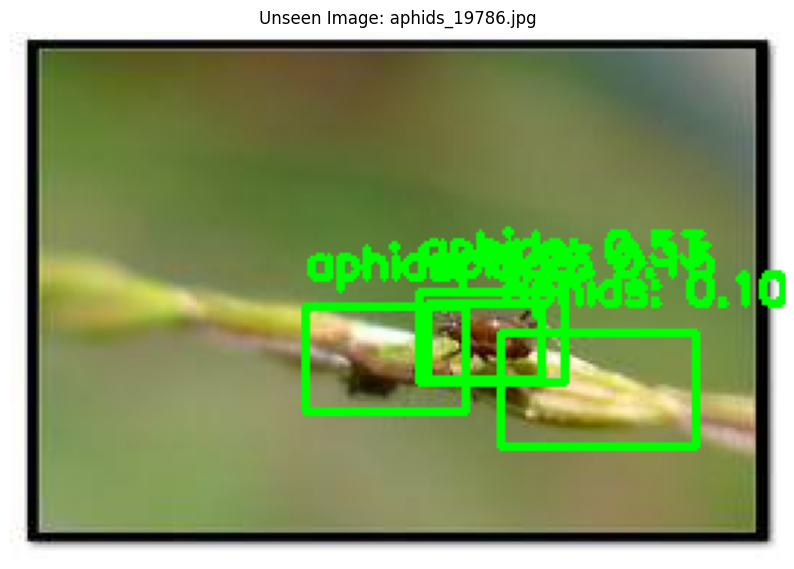


Detection Results for aphids_19786.jpg (Confidence Threshold 0.1):
Class: aphids, Confidence: 0.53, Box: [xmin=141, ymin=90, xmax=191, ymax=120]
Class: aphids, Confidence: 0.23, Box: [xmin=101, ymin=94, xmax=156, ymax=131]
Class: aphids, Confidence: 0.15, Box: [xmin=143, ymin=94, xmax=183, ymax=120]
Class: aphids, Confidence: 0.10, Box: [xmin=169, ymin=104, xmax=235, ymax=143]
Processing image: red spider_14111.jpg (640x480)


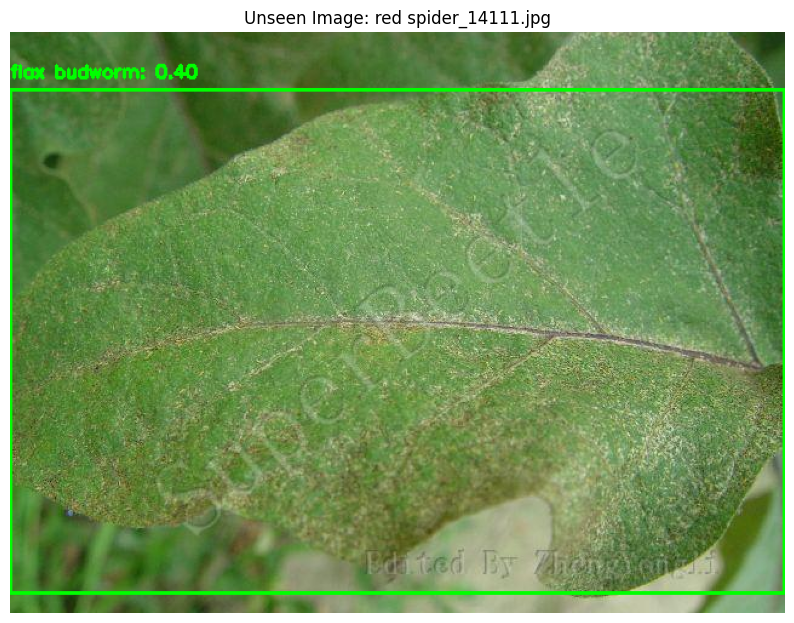


Detection Results for red spider_14111.jpg (Confidence Threshold 0.1):
Class: flax budworm, Confidence: 0.40, Box: [xmin=0, ymin=49, xmax=640, ymax=463]
Processing image: black cutworm_12184.jpg (289x226)


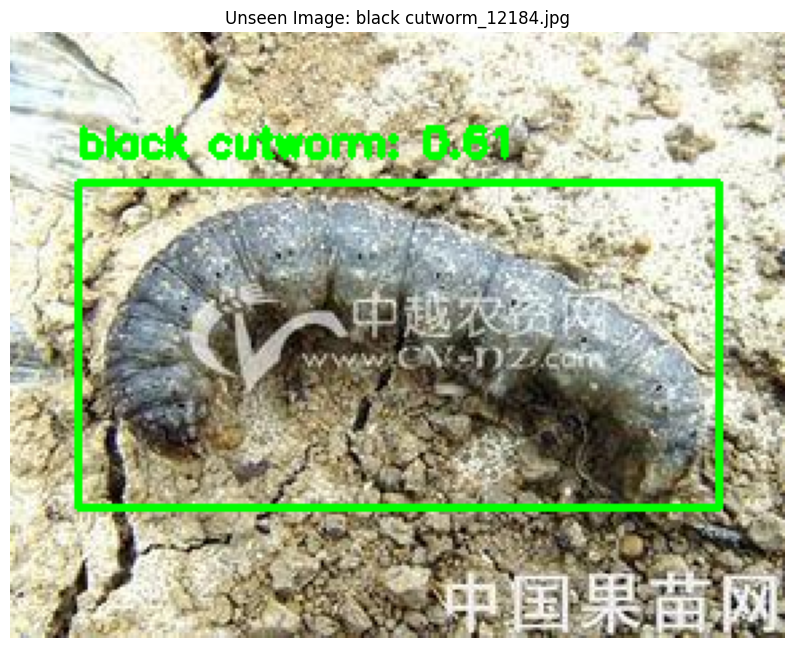


Detection Results for black cutworm_12184.jpg (Confidence Threshold 0.1):
Class: black cutworm, Confidence: 0.61, Box: [xmin=25, ymin=56, xmax=265, ymax=178]
Processing image: Unaspis yanonensis_60039.jpg (666x526)


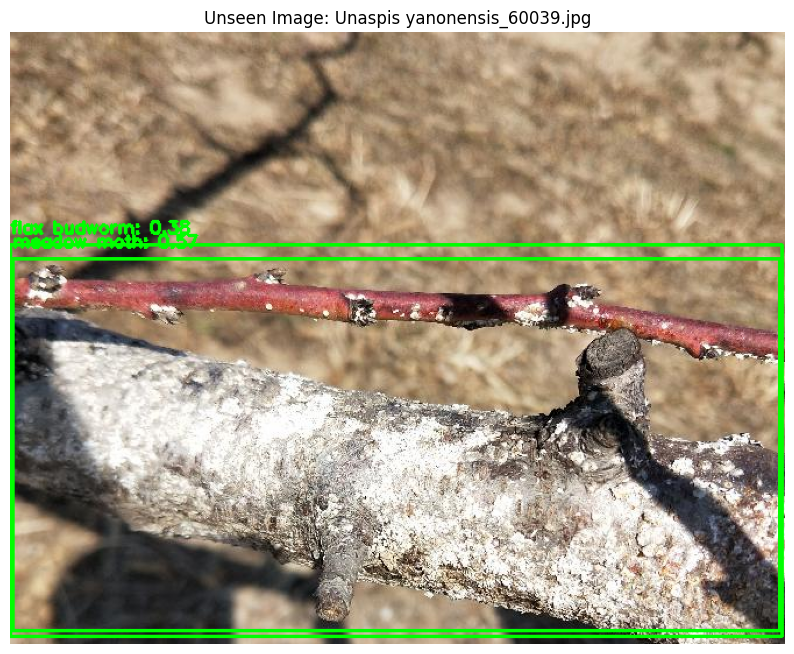


Detection Results for Unaspis yanonensis_60039.jpg (Confidence Threshold 0.1):
Class: meadow moth, Confidence: 0.57, Box: [xmin=2, ymin=195, xmax=662, ymax=515]
Class: flax budworm, Confidence: 0.38, Box: [xmin=1, ymin=183, xmax=664, ymax=519]
Processing image: Locust_LocustImage258.jpeg (976x549)


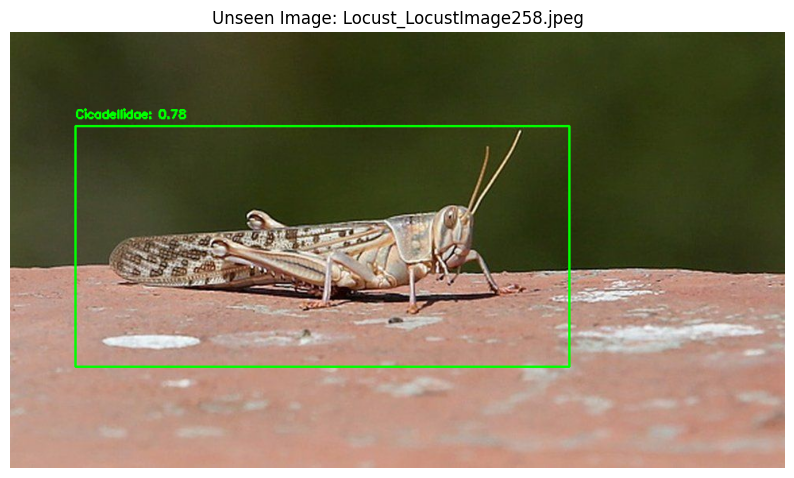


Detection Results for Locust_LocustImage258.jpeg (Confidence Threshold 0.1):
Class: Cicadellidae, Confidence: 0.78, Box: [xmin=83, ymin=118, xmax=705, ymax=421]
Processing image: Jute hairy_spilosoma_obliqua_0_2232.jpg (256x256)


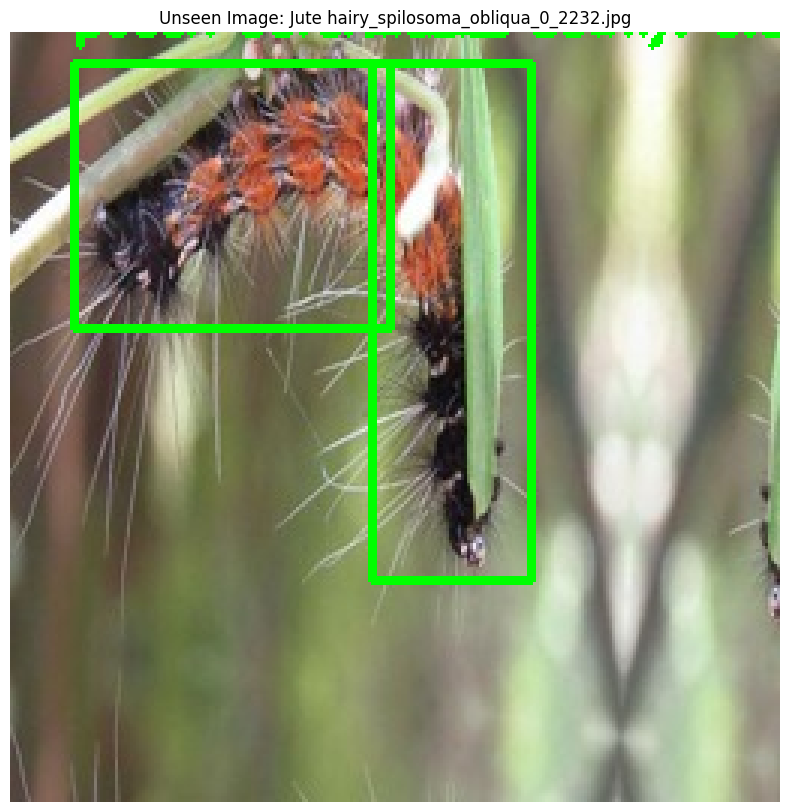


Detection Results for Jute hairy_spilosoma_obliqua_0_2232.jpg (Confidence Threshold 0.1):
Class: wheat sawfly, Confidence: 0.37, Box: [xmin=120, ymin=11, xmax=173, ymax=183]
Class: peach borer, Confidence: 0.18, Box: [xmin=22, ymin=11, xmax=127, ymax=99]
Processing image: alfalfa plant bug_32415.jpg (591x414)


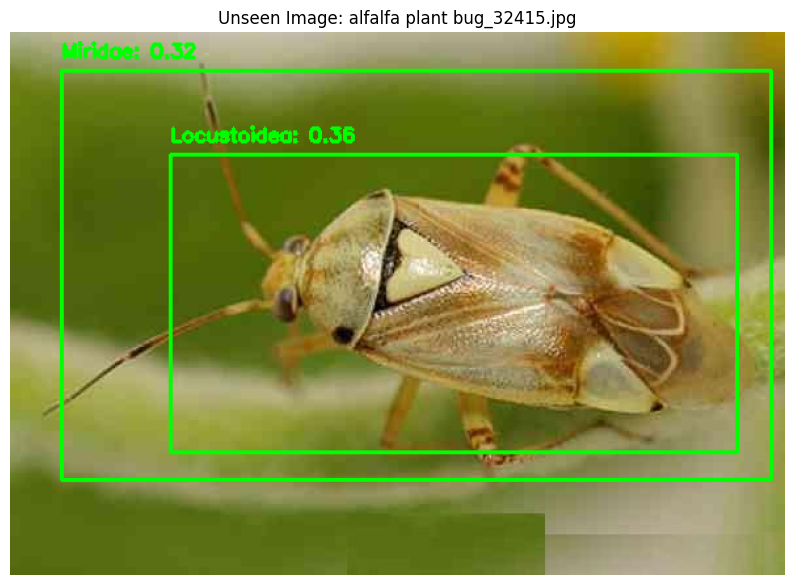


Detection Results for alfalfa plant bug_32415.jpg (Confidence Threshold 0.1):
Class: Locustoidea, Confidence: 0.36, Box: [xmin=123, ymin=93, xmax=554, ymax=321]
Class: Miridae, Confidence: 0.32, Box: [xmin=39, ymin=29, xmax=580, ymax=342]
Processing image: sawfly_jpg_44.jpg (270x187)


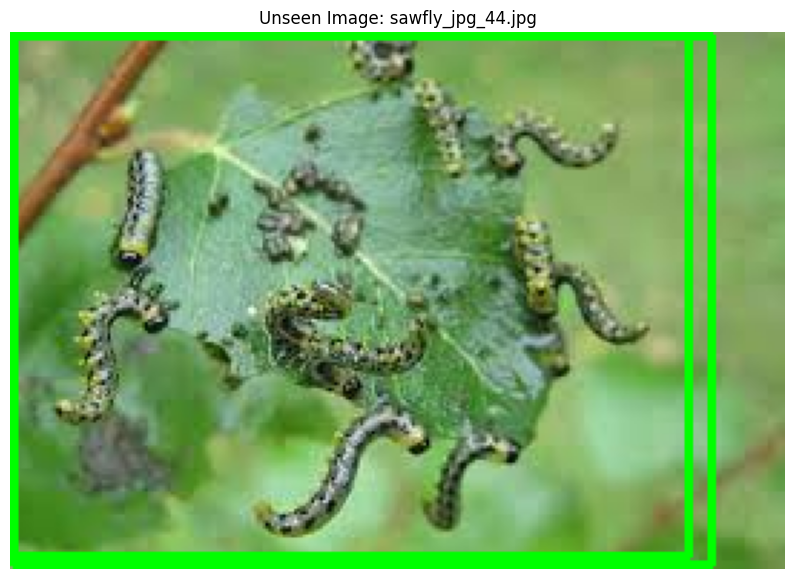


Detection Results for sawfly_jpg_44.jpg (Confidence Threshold 0.1):
Class: rice water weevil, Confidence: 0.29, Box: [xmin=1, ymin=1, xmax=236, ymax=183]
Class: Sternochetus frigidus, Confidence: 0.17, Box: [xmin=2, ymin=1, xmax=244, ymax=185]
Processing image: mites_jpg_10 - Copy (4).jpg (256x197)


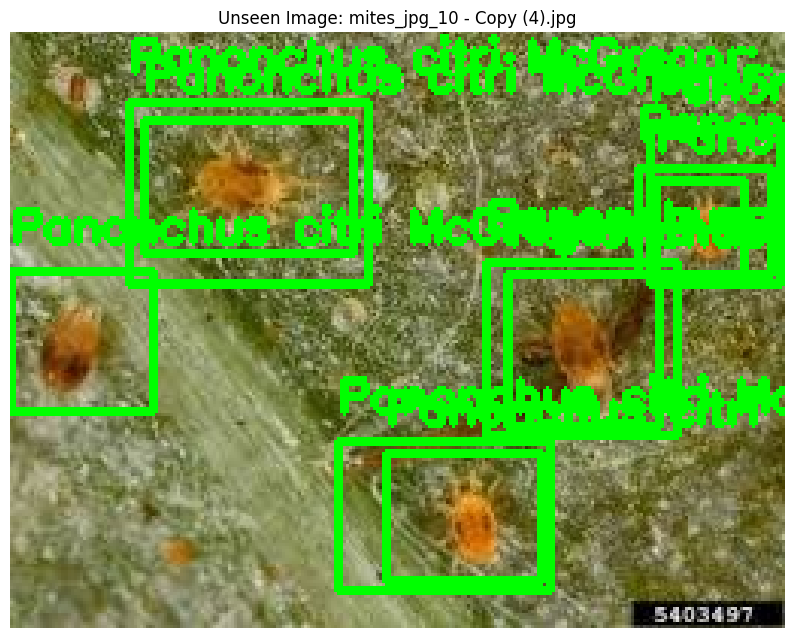


Detection Results for mites_jpg_10 - Copy (4).jpg (Confidence Threshold 0.1):
Class: Panonchus citri McGregor, Confidence: 0.66, Box: [xmin=0, ymin=80, xmax=47, ymax=126]
Class: Panonchus citri McGregor, Confidence: 0.62, Box: [xmin=44, ymin=29, xmax=113, ymax=74]
Class: Panonchus citri McGregor, Confidence: 0.49, Box: [xmin=207, ymin=45, xmax=252, ymax=81]
Class: Panonchus citri McGregor, Confidence: 0.35, Box: [xmin=157, ymin=76, xmax=221, ymax=134]
Class: Panonchus citri McGregor, Confidence: 0.32, Box: [xmin=125, ymin=139, xmax=176, ymax=181]
Class: Panonchus citri McGregor, Confidence: 0.19, Box: [xmin=214, ymin=49, xmax=243, ymax=81]
Class: Panonchus citri McGregor, Confidence: 0.12, Box: [xmin=211, ymin=32, xmax=255, ymax=83]
Class: Panonchus citri McGregor, Confidence: 0.11, Box: [xmin=109, ymin=136, xmax=178, ymax=185]
Class: Panonchus citri McGregor, Confidence: 0.11, Box: [xmin=164, ymin=80, xmax=214, ymax=130]
Class: Panonchus citri McGregor, Confidence: 0.11, Box: [xmin=4

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from ultralytics import YOLO
import yaml
import os

# Step 1: Load the Class Names from ip102.yaml
yaml_path = "/kaggle/working/ip102_corrected.yaml"
with open(yaml_path, 'r') as f:
    yaml_content = yaml.safe_load(f)
class_names = yaml_content['names']  # List of 102 pest class names

# Step 2: Load the Trained YOLOv11 Model
model_weights_path = "/kaggle/working/yolo_training/ip102_yolov8s2/weights/best.pt"
model = YOLO(model_weights_path)
print(f"Loaded trained YOLOv11 model from {model_weights_path}")

# Step 3: Define the Directory of Unseen Test Images
test_images_dir = "/kaggle/input/pest-test-images/"  # Directory containing test images
image_files = [f for f in os.listdir(test_images_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Step 4: Perform Inference on Each Test Image
for image_file in image_files:
    unseen_image_path = os.path.join(test_images_dir, image_file)
    img = cv2.imread(unseen_image_path)
    if img is None:
        print(f"Could not load image from {unseen_image_path}")
        continue
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    img_height, img_width = img.shape[:2]
    print(f"Processing image: {image_file} ({img_width}x{img_height})")

    # Run inference with a lower confidence threshold
    results = model.predict(
        source=unseen_image_path,
        conf=0.1,  # Lower confidence threshold
        iou=0.7,   # IoU threshold for NMS
        imgsz=416, # Match training image size
        device=0,  # Use GPU
        verbose=False
    )
    result = results[0]

    # Extract bounding boxes, class IDs, and confidence scores
    boxes = result.boxes.xyxy.cpu().numpy() if result.boxes else np.array([])
    confidences = result.boxes.conf.cpu().numpy() if result.boxes else np.array([])
    class_ids = result.boxes.cls.cpu().numpy().astype(int) if result.boxes else np.array([])

    # Draw bounding boxes and labels on the image
    if len(boxes) > 0:
        for box, conf, class_id in zip(boxes, confidences, class_ids):
            xmin, ymin, xmax, ymax = map(int, box)
            label = class_names[class_id]
            confidence = conf

            # Draw the bounding box
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

            # Add label with class name and confidence
            label_text = f"{label}: {confidence:.2f}"
            cv2.putText(img, label_text, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    else:
        print(f"No detections for {image_file} with confidence threshold 0.1")

    # Step 5: Display the Image
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Unseen Image: {image_file}")
    plt.show()

    # Step 6: Print Detection Results
    print(f"\nDetection Results for {image_file} (Confidence Threshold 0.1):")
    if len(boxes) > 0:
        for box, conf, class_id in zip(boxes, confidences, class_ids):
            print(f"Class: {class_names[class_id]}, Confidence: {conf:.2f}, Box: [xmin={box[0]:.0f}, ymin={box[1]:.0f}, xmax={box[2]:.0f}, ymax={box[3]:.0f}]")
    else:
        print("No detections found. Consider lowering the confidence threshold or retraining the model.")

Ultralytics 8.3.156 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 11,165,058 parameters, 0 gradients, 28.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 88.8±95.8 MB/s, size: 30.7 KB)


val: Scanning /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels/val... 1329 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1329/1329 [00:01<00:00, 1012.85it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/ip102-yolov5/IP102_YOLOv5/labels is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 84/84 [00:07<00:00, 10.81it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all       1329       1621      0.584      0.668      0.663      0.437
      rice leaf roller         12         13      0.657          1      0.986      0.727
 rice leaf caterpillar          8          8      0.271      0.375      0.251      0.149
     paddy stem maggot          2          2      0.334        0.5      0.546      0.328
    asiatic rice borer         12         13      0.719       0.79      0.809      0.502
     yellow rice borer          6          6      0.854      0.833       0.88       0.65
       rice gall midge          7          7      0.813      0.857       0.91      0.453
          Rice Stemfly          2          2       0.38        0.5       0.58      0.232
    brown plant hopper          8          8      0.631        0.5      0.608      0.362
white backed plant hopper          5          5      0.567          1      0.938      0.583
small brown plant hopper          4          4      0.672      0.515      0.794      0.401
     rice water 

ValueError: Unknown format code 'd' for object of type 'float'

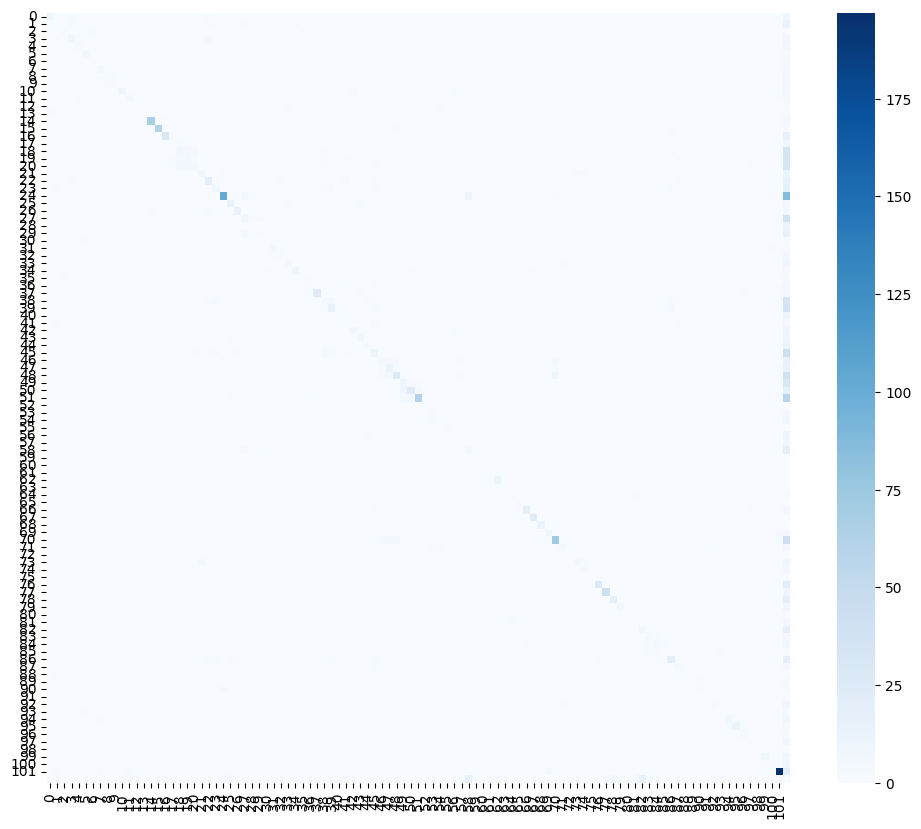

In [13]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the trained model
model_weights_path = "/kaggle/working/yolo_training/ip102_yolov8s2/weights/best.pt"  # Update to your best weights path
model = YOLO(model_weights_path)

# Step 1: Run Validation to Get Detailed Metrics
results = model.val(
    data="/kaggle/working/ip102_corrected.yaml",  # Path to your dataset YAML
    imgsz=416,                                   # Match training image size
    batch=16,                                    # Match training batch size
    conf=0.1,                                    # Confidence threshold
    iou=0.7,                                     # IoU threshold
    device=0,                                    # Use GPU
    verbose=True                                 # Print detailed output
)

# Step 2: Extract and Print Metrics
print("\nEvaluation Metrics:")
# Overall Metrics
print(f"Validation mAP@0.5: {results.box.map50:.4f}")
print(f"Validation mAP@0.5:0.95: {results.box.map:.4f}")
print(f"Overall Precision: {results.box.p.mean():.4f}")
print(f"Overall Recall: {results.box.r.mean():.4f}")
print(f"Overall F1-Score: {results.box.f1.mean():.4f}")
print(f"Inference Speed (ms): Preprocess {results.speed['preprocess']:.1f}, Inference {results.speed['inference']:.1f}, Postprocess {results.speed['postprocess']:.1f}")

# Per-Class Metrics
print("\nPer-Class Metrics:")
for i, (p, r, f1, m) in enumerate(zip(results.box.p, results.box.r, results.box.f1, results.box.maps)):
    class_name = model.names[i]  # Get class name from model
    print(f"Class: {class_name} (ID: {i}) - Precision: {p:.4f}, Recall: {r:.4f}, F1: {f1:.4f}, mAP@0.5:0.95: {m:.4f}")

# Step 3: Visualize Confusion Matrix
conf_matrix = results.confusion_matrix.matrix  # Get confusion matrix
plt.figure(figsize=(12, 10))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=model.names, yticklabels=model.names)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Class")
plt.ylabel("True Class")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# Step 4: Analyze Training Losses (from training results if saved)
# Assuming you have access to the training results object
if 'results' in locals() and hasattr(results, 'box_loss'):  # Check if from training
    print("\nTraining Loss History:")
    print(f"Box Loss: {results.box_loss[-1]:.4f}")
    print(f"Classification Loss: {results.cls_loss[-1]:.4f}")
    print(f"DFL Loss: {results.dfl_loss[-1]:.4f}")
else:
    print("Training loss history not available. Run training again to capture losses.")